# Read .mot motion data (HDF5) using tables

In [1]:
import numpy as np
np.set_printoptions(threshold=10)#np.nan

In [10]:
import tables
import os

farneback = os.getcwd() + "/motion_vectors_farneback2.hdf5"
h264 = os.getcwd() + "/motion_vectors_h264.h5"
h264_median = os.getcwd() + "/motion_vectors_h264_median.hdf"


f = tables.open_file(farneback, mode='r')
f1 = tables.open_file(h264, mode='r')
f2 = tables.open_file(h264_median, mode='r')

In [11]:
f.root.motion_tensor

/motion_tensor (EArray(30017, 67, 120, 2)) ''
  atom := Float32Atom(shape=(), dflt=0.0)
  maindim := 0
  flavor := 'numpy'
  byteorder := 'little'
  chunkshape := (2, 67, 120, 2)

In [12]:
a = f.root.motion_tensor
b = f1.root.motion_tensor
c = f2.root.motion_tensor

## Median filter h264 motion

In [ ]:
c = np.ndarray(b.shape)

In [5]:
c.shape

(30020, 67, 120, 2)

In [20]:
from scipy.ndimage import median_filter

c[:,:,:,0] = median_filter(b[:,:,:,0], size = 2)
c[:,:,:,1] = median_filter(b[:,:,:,1], size = 2)

In [26]:
c.shape

(30020, 67, 120, 2)

In [25]:
f = tables.open_file('motion_vectors_h264_median.hdf', 'w')
atom = tables.Atom.from_dtype(np.int32)
ds = f.create_carray(f.root, 'motion_tensor', atom, c.shape)
ds[:] = c
f.close()

# Single frame strength of motion

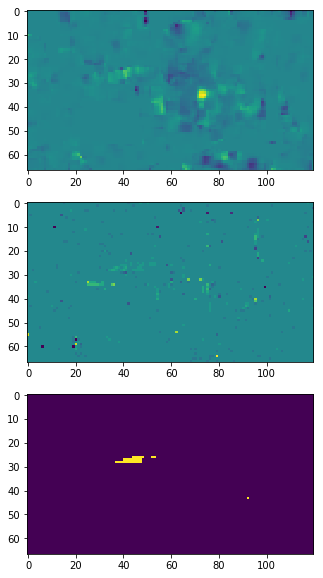

In [32]:
import matplotlib.pyplot as plt
%matplotlib inline

frame = 1

fig = plt.figure(figsize = (10,10))
ax = fig.add_subplot(311)
ax1 = fig.add_subplot(312)

U = a[frame][:,:,0]
V = a[frame][:,:,1]
im = ax.imshow(V+U)

U1 = b[frame][:,:,0]
V1 = b[frame][:,:,1]
im = ax1.imshow(V1+U1)

U2 = c[frame][:,:,0]
V2 = c[frame][:,:,1]
ax2 = fig.add_subplot(313)
im = ax2.imshow(U2+V2)

#fig.colorbar(im)
fig.show()

In [16]:
%matplotlib notebook
import matplotlib.pyplot as plt
import matplotlib.animation
import numpy as np
import cv2
import imageio

width = 120
height = 67

matplotlib.rcParams['animation.embed_limit'] = 2**128


#video_file = os.getcwd() + "\\in\\00_sth.mov"
video_file = os.getcwd() + "/RPS_05_PS_C2.wmv"

cap = cv2.VideoCapture(video_file)
video_reader = imageio.get_reader(video_file)

plt.ioff()

start_frame = 300#300
cap.set(1, start_frame)#jump to correct frame
frames = 20#30SUBJECT TO BE CHANGED
skip_factor = 1#speed up playback by skipping frames

.....................

<IPython.core.display.Javascript object>


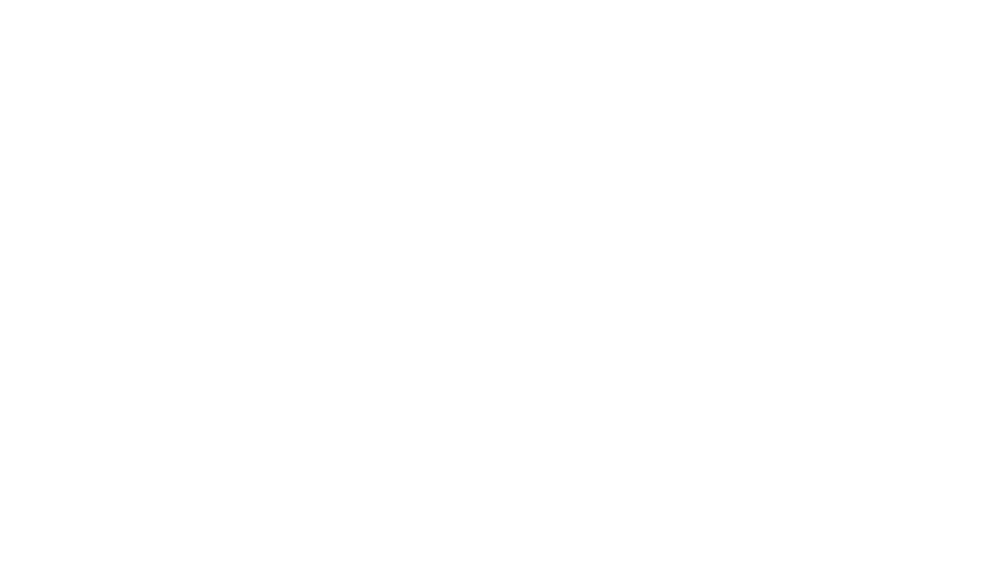

Traceback (most recent call last):
  File "/home/gerstenberger/miniconda3/lib/python3.6/site-packages/matplotlib/cbook/__init__.py", line 215, in process
    func(*args, **kwargs)
  File "/home/gerstenberger/miniconda3/lib/python3.6/site-packages/matplotlib/animation.py", line 1478, in _stop
    self.event_source.remove_callback(self._loop_delay)
AttributeError: 'NoneType' object has no attribute 'remove_callback'


In [32]:
rescaled = a[0]#cv2.resize(a[0], (64,36)) 

X, Y = np.meshgrid(np.arange(width), np.arange(height))


fig, ax = plt.subplots(1,1, figsize = (16,9))
Q = ax.quiver(X, Y, np.flipud(rescaled[:,:,0]), -np.flipud(rescaled[:,:,1]), 
              units='xy', color='g', scale = 1.0)
ax.imshow(cap.read()[1])

def animate(i):
    print(".", end ="")
    i *= skip_factor#skip frames
    
    img = video_reader.get_data(start_frame+ i)
    ax.imshow(cv2.resize(img, (256,144)), extent = [0,width,0,height], origin = "upper")
    
    rescaled = np.array(a[start_frame+i], dtype=np.float32)#cv2.resize(a[start_frame+i], (64,36))
    #rescaled = rescaled / 16.0
    rescaled = cv2.resize(rescaled, (width,height)) 
    
    
    Q.set_UVC(np.flipud(rescaled[:,:,0]), -np.flipud(rescaled[:,:,1]))

ani = matplotlib.animation.FuncAnimation(fig, animate, frames=frames)

from IPython.display import HTML
HTML(ani.to_jshtml())

.....................

<IPython.core.display.Javascript object>


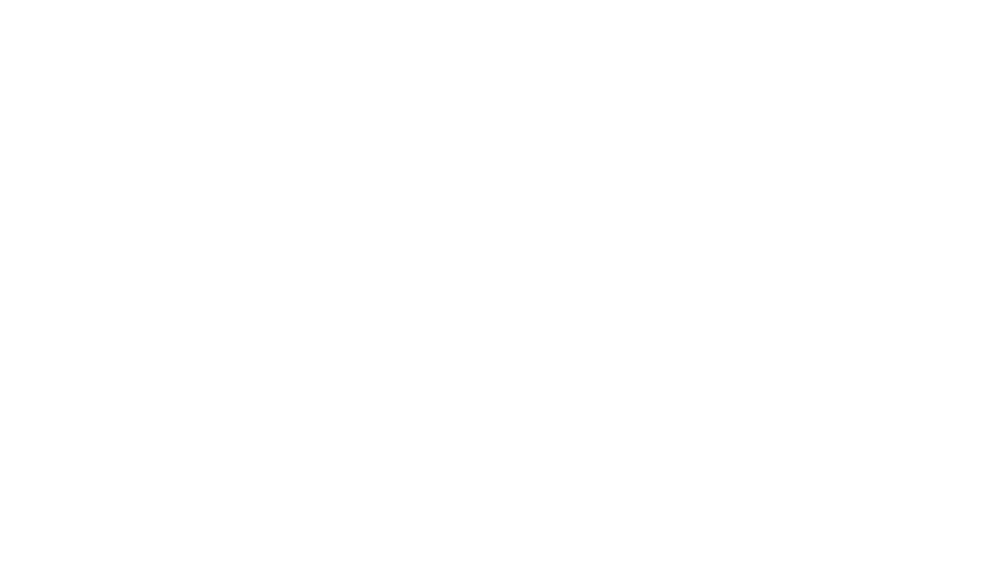

Traceback (most recent call last):
  File "/home/gerstenberger/miniconda3/lib/python3.6/site-packages/matplotlib/cbook/__init__.py", line 215, in process
    func(*args, **kwargs)
  File "/home/gerstenberger/miniconda3/lib/python3.6/site-packages/matplotlib/animation.py", line 1478, in _stop
    self.event_source.remove_callback(self._loop_delay)
AttributeError: 'NoneType' object has no attribute 'remove_callback'


In [30]:

rescaled = b[0]#cv2.resize(a[0], (64,36))

X, Y = np.meshgrid(np.arange(width), np.arange(height))


fig, ax = plt.subplots(1,1, figsize = (16,9))
Q = ax.quiver(X, Y, np.flipud(rescaled[:,:,0]), -np.flipud(rescaled[:,:,1]), 
              units='xy', color='g', scale = 1.0)
ax.imshow(cap.read()[1])

lala = None
def animate(i):
    print(".", end ="")
    i *= skip_factor#skip frames
    
    img = video_reader.get_data(start_frame+ i)
    ax.imshow(cv2.resize(img, (256,144)), extent = [0,width,0,height], origin = "upper")
    
    rescaled = np.array(b[start_frame+i], dtype=np.float32)#cv2.resize(a[start_frame+i], (64,36))
    #rescaled = rescaled / 16.0
    rescaled = cv2.resize(rescaled, (width,height)) 
    
    
    Q.set_UVC(np.flipud(rescaled[:,:,0]), -np.flipud(rescaled[:,:,1]))

ani = matplotlib.animation.FuncAnimation(fig, animate, frames=frames)

from IPython.display import HTML
HTML(ani.to_jshtml())

.....................

.

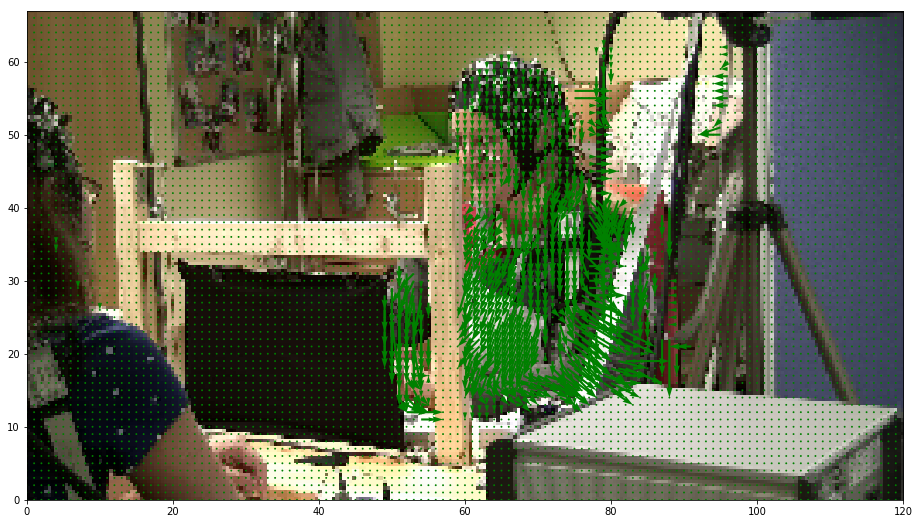

In [33]:
rescaled = c[0]#cv2.resize(a[0], (64,36))

X, Y = np.meshgrid(np.arange(width), np.arange(height))


fig, ax = plt.subplots(1,1, figsize = (16,9))
Q = ax.quiver(X, Y, np.flipud(rescaled[:,:,0]), -np.flipud(rescaled[:,:,1]), 
              units='xy', color='g', scale = 1.0)
ax.imshow(cap.read()[1])

def animate(i):
    print(".", end ="")
    i *= skip_factor#skip frames
    
    img = video_reader.get_data(start_frame+ i)
    ax.imshow(cv2.resize(img, (256,144)), extent = [0,width,0,height], origin = "upper")
    
    rescaled = np.array(c[start_frame+i], dtype=np.float32)#cv2.resize(a[start_frame+i], (64,36))
    #rescaled = rescaled / 16.0
    rescaled = cv2.resize(rescaled, (width,height)) 
    
    
    Q.set_UVC(np.flipud(rescaled[:,:,0]), -np.flipud(rescaled[:,:,1]))

ani = matplotlib.animation.FuncAnimation(fig, animate, frames=frames)

from IPython.display import HTML
HTML(ani.to_jshtml())

In [ ]:
%matplotlib notebook
import matplotlib.pyplot as plt
import matplotlib.animation
import numpy as np
import cv2
import imageio

width = 120
height = 67

matplotlib.rcParams['animation.embed_limit'] = 2**128


#video_file = os.getcwd() + "\\in\\00_sth.mov"
video_file = os.getcwd() + "/RPS_05_PS_C2.wmv"

cap = cv2.VideoCapture(video_file)
video_reader = imageio.get_reader(video_file)

plt.ioff()

start_frame = 300#300
cap.set(1, start_frame)#jump to correct frame
frames = 20#30SUBJECT TO BE CHANGED
skip_factor = 1#speed up playback by skipping frames
rescaled = a[0]#cv2.resize(a[0], (64,36)) 


X, Y = np.meshgrid(np.arange(width), np.arange(height))


fig, ax = plt.subplots(1,1, figsize = (16,9))
Q = ax.quiver(X, Y, np.flipud(rescaled[:,:,0]), -np.flipud(rescaled[:,:,1]), 
              units='xy', color='g', scale = 1.0)
ax.imshow(cap.read()[1])

lala = None
def animate(i):
    print(".", end ="")
    i *= skip_factor#skip frames
    
    img = None
    if(False):
        cap.set(1, start_frame + i)
        ret, img = cap.read()
    else:
        img = video_reader.get_data(start_frame+ i)
    ax.imshow(cv2.resize(img, (256,144)), extent = [0,width,0,height], origin = "upper")
    
    rescaled = np.array(a[start_frame+i], dtype=np.float32)#cv2.resize(a[start_frame+i], (64,36))
    #rescaled = rescaled / 16.0
    rescaled = cv2.resize(rescaled, (width,height)) 
    
    
    Q.set_UVC(np.flipud(rescaled[:,:,0]), -np.flipud(rescaled[:,:,1]))

ani = matplotlib.animation.FuncAnimation(fig, animate, frames=frames)

from IPython.display import HTML
HTML(ani.to_jshtml())

In [ ]:
def correct_global_trend(vector_array):
    out = np.ndarray((vector_array.shape[0],vector_array.shape[1],vector_array.shape[2]))
    
    ary = np.array([vector_array[:,:,0].flatten(),vector_array[:,:,1].flatten()])
    deg = np.degrees(np.arctan2(ary[0],ary[1]))+180
    deg = deg.reshape((vector_array.shape[0], vector_array.shape[1]))
    
    bins = (np.arange(36 +1)*10) #start at 0 go up to 360. Mind the rightmost edge has to be defined, hence +1.
    hist, edges = np.histogram(deg, bins = bins)
    ranges = [range(a,b) for a, b in zip(edges, edges+10)][:-1]#yields 36 ranges [[0,10]...[350,360]]
    
    hist = hist/hist.sum()
    
    visited = False
    # Go through degrees. Check in which bin each entry fits. Weigh vector array entries according to value.
    for y in range(deg.shape[0]):
        for x in range(deg.shape[1]):
            visited = False
            for r, i in zip(ranges, range(len(ranges))):
                if int(deg[y][x]) in r:
                        out[y][x] = vector_array[y][x]*1/(hist[i])
                        visited = True
            if(not visited): #Assume the value was 360
                out[y][x] = vector_array[y][x]*(1/hist[-1])                
    return out

In [70]:
def histogram(vector_array, weighted=True):
    """ Computes weighted histograms
    Returns: Weighted Histogram with 36 bins (), bin edges, 
            2d array of directions in degree (upwards, rightwards, downwards, leftwards),
            2d array of lengths of vectors """
    ary = np.array([vector_array[:,:,0].flatten(),vector_array[:,:,1].flatten()])
    deg = np.degrees(np.arctan2(ary[0],ary[1]))+180
    length = np.linalg.norm(ary, axis = 0)#.reshape(d[0].shape[0:2])
    bins = (np.arange(36 +1)*10) #start at 0 go up to 360. Mind the rightmost edge has to be defined, hence +1.
    
    hist = None
    bin_edges = None
    if weighted:
        hist, bin_edges = np.histogram(deg, weights = length, bins = bins)
    else:
        hist, bin_edges = np.histogram(deg, bins = bins)
    
    return hist, bin_edges, deg.reshape((vector_array.shape[0], vector_array.shape[1])), length.reshape((vector_array.shape[0], vector_array.shape[1]))
    

In [3]:
import numpy as np
import matplotlib.pyplot as plt
def compute_weighted_histograms(data, frame_range= None, preprocess = False):
    
    if frame_range:
        data = data[frame_range[0]:frame_range[1]]
        if preprocess:
            print("prepare")
            for x in range(data.shape[0]):
                print("trendremoval")
                data[x] = correct_global_trend(data[x])
            #data = medianfilter_intensity(data, size = 4, threshold =2)#Remove isolated large vectors
    
    #coordinates = np.array(coordinates)//6#.mot is 1/6 size as compared to video coordinates

    outary = np.ndarray((data.shape[0],35))

    for d, i in zip(data, range(data.shape[0])):
        ary = np.array([d[:,:,0].flatten(),d[:,:,1].flatten()])
        deg = np.degrees(np.arctan2(ary[0],ary[1]))#.reshape(d[0].shape[0:2])
        length = np.linalg.norm(ary, axis = 0)#.reshape(d[0].shape[0:2])
        bins = (np.arange(36)*10)-170 #start at -170. Go up in steps of 10 to 180
        weightedHist, bin_edges = np.histogram(deg, weights = length, bins = bins)
        outary[i] = weightedHist
        if i%100 == 0:
            print(i/data.shape[0])
    return outary    

In [20]:
mothistmap = compute_weighted_histograms(c, [0,600])

0.0
0.16666666666666666
0.3333333333333333
0.5
0.6666666666666666
0.8333333333333334


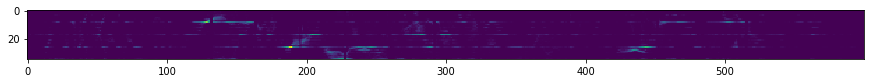

In [21]:
%matplotlib inline
fig = plt.subplots(figsize=(15,15))
plt.imshow(mothistmap.T)

In [ ]:
%matplotlib inline
plt.imshow(mothistmap.T)

In [ ]:
import matplotlib.pyplot as plt